# **Домашнее задание №1 (pro). Часть 1**

В этом домашнем задании (его первой части) вам будет необходимо:
*  обучить модель регрессии для предсказания стоимости автомобилей;


> Оценка за первую часть домашки = $min(\text{ваш балл}, 7)$



**Примечание**

В каждой части оцениваются как код, **так и ответы на вопросы.** Вопросы подсвечены синим цветом.

Если нет одного и/или другого, то часть баллов за соответствующее задание снимается.

In [1]:
%pip install ydata_profiling

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 398.7/398.7 kB 14.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.7/296.7 kB 23.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 80.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.7/679.7 kB 48.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 4.1 MB/s eta 0:00:00


In [115]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import seaborn as sns
from ydata_profiling import ProfileReport
import re
import phik
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error as MSE
import pickle

random.seed(42)
np.random.seed(42)

import warnings
warnings.filterwarnings("ignore")

### **Задание 0**
Давайте зафиксируем важный момент.

**Задание 0 (0 баллов).**
Изучите и ответье на вопрос: для чего фиксируем сиды в домашках?

> Чтобы при каждом запуске ячейки была одна и та же генерация. Например, чтобы в train и test отбирались одни и те же объекты

# **Часть 1 | EDA**


Первая часть состоит из классических шагов EDA:

- Базовый EDA и обработка признаков (1.7 балла)
- Визуализации признаков и их анализ (1.6 балл)

Всего можно набрать 3.3 основных балла и 0.25 бонусных.

В следующих частях, вы увидите бонусные задания. Бонусные задания выделены как **Дополнительное задание/Бонус**. Вы можете выполнять их, чтобы в случае ошибок в основных задачах всё равно набрать за работу максимум. Кроме того, дополнительные задания позволяют вам углубить знания.

Призываем активно использовать их!

## **Простейший EDA и обработка признаков (1.7 балла)**

In [3]:
df_train = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_train.csv')
df_test = pd.read_csv('https://raw.githubusercontent.com/Murcha1990/MLDS_ML_2022/main/Hometasks/HT1/cars_test.csv')

print("Train data shape:", df_train.shape)
print("Test data shape: ", df_test.shape)

Train data shape: (6999, 13)
Test data shape:  (1000, 13)


### **Задание 1.(0.4 балла)**
Выполните операции, направленные на базовое исследование данных:

- [ ] Посмотрите, есть ли в датасете пропуски и дубликаты. Запишите/выведите названия колонок, для которых есть пропущенные значения (0.1 балла)
- [ ] Посмотрите, есть ли в данных явные дубликаты (0.05 балла)
- [ ] Постройте дашборд в одну строку, используя [ydata-profilling](https://github.com/ydataai/ydata-profiling)(0.15 балла)
- [ ] Опишите базовые выводы (какие — выберите сами), используя дашборд (0.2 балла).

#### Обработка **max_power**

In [4]:
def fix_max_power(df):
  for i in range(0, len(df)):
    try:
      ffil_value = float(df.loc[i, 'max_power'][:-4])
      df.loc[i, 'max_power'] = ffil_value

    except:
      if df.loc[i, 'max_power'] in [np.nan, 'nan']:
        continue
      elif df.loc[i, 'max_power'] == '0':
        ffil_value = float(df.loc[i, 'max_power'])
        df.loc[i, 'max_power'] = ffil_value
      else:
        df.loc[i, 'max_power'] = 0

In [5]:
fix_max_power(df_train)
fix_max_power(df_test)

In [6]:
df_train['max_power'] = pd.to_numeric(df_train['max_power'])
df_test['max_power'] = pd.to_numeric(df_test['max_power'])

#### Обработка **mileage**

In [7]:
print(f'Units of measurement (mileage):')
print(*df_train['mileage'].dropna().str.split().str[-1].unique(), sep=', ')

Units of measurement (mileage):
kmpl, km/kg


In [8]:
# Посмотрим с каким топливом встречаются единицы измерения
df_train['mileage_unit'] = df_train['mileage'].dropna().str.split().str[-1]
unit_by_fuel = df_train.groupby(['fuel', 'mileage_unit']).size().reset_index(name='count')
print(unit_by_fuel)

     fuel mileage_unit  count
0     CNG        km/kg     48
1  Diesel         kmpl   3696
2     LPG        km/kg     31
3  Petrol         kmpl   3022


In [9]:
df_train.drop("mileage_unit", axis=1, inplace=True)

Diesel, Petrol - дизель/бензин: жидкое топливо

CNG, LPG - газ

Данных с km/kg достаточно мало. Как будто можно было бы просто убрать единицы измерения, т.к. во-первых, они похожи по масштабу, во-вторых, km/kg встречается с газом, а kmpl с жидким топливом. Но все-таки при стандартизации в дальнейшем нужна единая единица измерения. Поэтому я переведу km/kg в kmpl через плотность топлива.

| Топливо | Плотность (кг/л) |
|--------|------------------|
| LPG    | 0.54        |
| CNG    | 0.17        |

Примерные плотности взяты из ChatGPT


In [10]:
def kmkg_to_kmpl(mileage_str, fuel_type):
  if pd.isna(mileage_str):
    return None

  gas_density = {'LPG': 0.54, 'CNG': 0.17}

  parts = mileage_str.lower().split()
  mileage_value = float(parts[0])
  unit_of_measure = parts[1]

  if unit_of_measure == 'km/kg':
    return mileage_value * gas_density[fuel_type]  # km/kg * kg/l = km/l
  else:
    return mileage_value

In [11]:
df_train["mileage"] = df_train.apply(lambda row: kmkg_to_kmpl(row["mileage"], row["fuel"]), axis=1)
df_test["mileage"] = df_test.apply(lambda row: kmkg_to_kmpl(row["mileage"], row["fuel"]), axis=1)

#### Обработка **torque**

In [12]:
df_train['torque'][:5]

,torque
0,190Nm@ 2000rpm
1,250Nm@ 1500-2500rpm
2,22.4 kgm at 1750-2750rpm
3,"11.5@ 4,500(kgm@ rpm)"
4,113.75nm@ 4000rpm


> Torque - крутящий момент, измеряется в Ньютон-метрах (Nm), что относится к части до @. Дальше идет информация об обороты двигателя (rpm, revolutions per minute), которую можно отбросить. Вторая часть просто показывает при каком количестве оборотов достигается крутящий момент, что звучит вторично.

In [13]:
def extract_torque_and_rpm(torque_str):
    if pd.isna(torque_str):
        return None, None

    torque_str = torque_str.lower()

    # Крутящий момент
    torque_match = re.search(r'(\d+\.?\d*)\s*(nm|kgm)', torque_str)
    if not torque_match:
        torque_match = re.search(r'(\d+\.?\d*)', torque_str)
        if not torque_match:
            return None, None

    torque_value = float(torque_match.group(1))
    if torque_match.lastindex >= 2 and torque_match.group(2) == 'kgm':
        torque_value = torque_value * 9.80665

    # Обороты
    rpm_value = None
    rpm_range_match = re.search(r'(\d+)\s*-\s*(\d+)\s*rpm', torque_str) # Ищем диапазон
    if rpm_range_match:
        rpm_value = float(rpm_range_match.group(2).replace(',', '')) # Берем вторую группу (максимум)
    else:
        rpm_single_match = re.search(r'[@at]\s*(\d+[\d,]*)', torque_str) # Если не диапазон
        if rpm_single_match:
            rpm_value = float(rpm_single_match.group(1).replace(',', ''))

    return torque_value, rpm_value

df_train[['torque', 'max_torque_rpm']] = df_train['torque'].apply(
    lambda x: pd.Series(extract_torque_and_rpm(x))
)
df_test[['torque', 'max_torque_rpm']] = df_test['torque'].apply(
    lambda x: pd.Series(extract_torque_and_rpm(x))
)

#### Обработка **engine**

In [14]:
def fix_engine(df):
  df['engine'] = df['engine'].str.replace(' CC','').astype(float)

fix_engine(df_train)
fix_engine(df_test)

#### Basic EDA

In [15]:
def basic_EDA(part_type, df):
  print(f"{part_type} ANALYSIS")
  missing = df.isna().sum()
  missing = missing[missing>0]
  print(f'\nColumns with missing values in df_{part_type.lower()}:')
  print(*missing.index.to_list(), sep=', ')

  print(f"\nDuplicated rows in df_{part_type.lower()}: {int(df.duplicated().sum())}")

  profile = ProfileReport(df, title=f"Profiling Report {part_type.capitalize()}")
  profile.to_notebook_iframe()

In [16]:
basic_EDA('TRAIN', df_train)

TRAIN ANALYSIS

Columns with missing values in df_train:
mileage, engine, max_power, torque, seats, max_torque_rpm

Duplicated rows in df_train: 985


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 14/14 [00:00<00:00, 37.25it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
basic_EDA('TEST', df_test)

TEST ANALYSIS

Columns with missing values in df_test:
mileage, engine, max_power, torque, seats, max_torque_rpm

Duplicated rows in df_test: 62


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 14/14 [00:00<00:00, 53.95it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

> В трейне достаточно много дубликатов (7%), но самое большое число дубликатов - 8, и в данном случае дубликаты могут просто указывать на несколько реальных машин с одинаковыми характеристиками


>  Есть пропущенные значения в следующих столбцах: max_power, seats, mileage, torque, engine

> Самые высокие стаблильные (есть и в train и в test) корреляции с **selling_price**: year, max_power, engine, torque

> Что странно, mileage_clean слабо коррелирует с selling_price

**Стабильные высокие корреляции между признаками**:

- engine, max_power (0.736 vs 0.774)
- engine, torque (0.722 vs 0.729)
- max_power, torque (0.725 vs 0.739)

**Изменившиеся корреляции**:
- fuel, max_power: 0.168 -> 0.238 (+42%)
- transmission, selling_price: 0.586 -> 0.628 (+7%)
- seller_type, selling_price: 0.282 -> 0.364 (+29%)
- owner, selling_price: 0.364 -> 0.165 (-55%)
- fuel, km_driven: 0.035 -> 0.174 (+397%)



> Ключевые переменные стабильны, но сильно коррелируют между собой

### **Задание 2 (0.2 балла)**
Проанализируйте статистики датасета.

**Ваша задача:**
- [ ] Посчитайте основные статистики по числовым столбцам для трейна и теста
- [ ] Посчитайте основные статистики по категориальным столбцам для трейна и теста
- [ ] Сравните среднее и медиану внутри `train`, внутри `test` и между собой. О чём могут говорить результаты?
- [ ] Сделайте выводы по статистикам. Отсутсвие выводов равносильно по баллам невыполнению задания.

**Подсказка:**

Используте ``.describe()`` с нужным(и) аргументом(-ами).

In [18]:
print("Num columns - TRAIN:")
print(df_train.describe(include=['number']))
print("\nNum columns - TEST:")
print(df_test.describe(include=['number']))

print("\nCat columns - TRAIN:")
print(df_train.describe(include=['object']))
print("\nCat columns - TEST:")
print(df_test.describe(include=['object']))

Num columns - TRAIN:
              year  selling_price     km_driven      mileage       engine  \
count  6999.000000   6.999000e+03  6.999000e+03  6797.000000  6797.000000   
mean   2013.818403   6.395152e+05  6.958462e+04    19.245168  1458.327203   
std       4.053095   8.089419e+05  5.772400e+04     4.235327   501.183890   
min    1983.000000   2.999900e+04  1.000000e+00     0.000000   624.000000   
25%    2011.000000   2.549990e+05  3.500000e+04    16.780000  1197.000000   
50%    2015.000000   4.500000e+05  6.000000e+04    19.160000  1248.000000   
75%    2017.000000   6.750000e+05  9.700000e+04    22.300000  1582.000000   
max    2020.000000   1.000000e+07  2.360457e+06    42.000000  3604.000000   

         max_power       torque        seats  max_torque_rpm  
count  6803.000000  6796.000000  6797.000000     6760.000000  
mean     91.486573   170.380198     5.419008     3054.196450  
std      35.836164    95.940886     0.965767      953.208467  
min       0.000000     5.700000  

**Ключевые выводы**:
- Распределения категориальных признаков стабильны между трейном и тестом, отличается только top name

- Небольшие различия в возрасте (2014 в тесте vs. 2015 в трейне)

- Обнаружены возможные выбросы в трейне в признаках max_torque_rpm (21.800), km_driven (2.36 млн км)



### **Задание 3 (0.2 балла)**

- [ ] Посмотрите, есть ли в трейне объекты с одинаковым признаковым описанием (целевую переменную следует исключить). Если есть, то сколько? (0.01 балла)
- [ ] Отобразите такие объекты (0.01 балла)
- [ ] Удалите повторяющиеся строки. Если при одинаковом признаковом описании цены на автомобили отличаются, то оставьте первую строку по этому автомобилю (0.01 балла)
- [ ]  Обновите индексы строк таким образом, чтобы они шли от 0 без пропусков (0.01 балла)
- [ ] Подумайте, могут ли в данных быть другие скрытые дубли? Предложите, как их можно отлавливать. (0.16 балла)

P.S тут данные без подвоха, но выводы нам нужны.

In [19]:
X_duplicated_mask = df_train.drop('selling_price', axis=1).duplicated(keep=False)

In [20]:
num_duplicates = X_duplicated_mask.sum()
print(f"Количество объектов с одинаковым признаковым описанием: {num_duplicates}")

Количество объектов с одинаковым признаковым описанием: 1799


In [21]:
duplicated_rows = df_train[X_duplicated_mask]
print("Объекты с одинаковым признаковым описанием:")
duplicated_rows.sort_values(by=df_train.drop('selling_price', axis=1).columns.tolist())

Объекты с одинаковым признаковым описанием:


,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats,max_torque_rpm
1703,Audi Q3 2.0 TDI Quattro Premium Plus,2017,2825000,22000,Diesel,Dealer,Automatic,First Owner,15.73,1968.0,174.33,380.0,5.0,2500.0
6307,Audi Q3 2.0 TDI Quattro Premium Plus,2017,2825000,22000,Diesel,Dealer,Automatic,First Owner,15.73,1968.0,174.33,380.0,5.0,2500.0
1836,Audi Q5 3.0 TDI Quattro,2014,1850000,76131,Diesel,Individual,Automatic,First Owner,13.22,2967.0,241.40,580.0,5.0,3250.0
6704,Audi Q5 3.0 TDI Quattro,2014,1850000,76131,Diesel,Individual,Automatic,First Owner,13.22,2967.0,241.40,580.0,5.0,3250.0
117,Audi Q5 35TDI Premium Plus,2018,3975000,31800,Diesel,Dealer,Automatic,First Owner,17.01,1968.0,188.00,400.0,5.0,3000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5637,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.00,1969.0,190.00,400.0,5.0,NaN
5652,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.00,1969.0,190.00,400.0,5.0,NaN
5753,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.00,1969.0,190.00,400.0,5.0,NaN
5991,Volvo XC40 D4 Inscription BSIV,2019,3800000,20000,Diesel,Individual,Automatic,First Owner,18.00,1969.0,190.00,400.0,5.0,NaN


In [22]:
df_train = df_train.drop_duplicates(subset=df_train.drop('selling_price', axis=1).columns.tolist(), keep='first')

In [23]:
df_train.reset_index(drop=True, inplace=True)

In [24]:
# На этом этапе у меня уже есть max_torque_rpm, поэтому на один столбец больше
df_train.shape

(5840, 14)

In [25]:
assert df_train.drop("max_torque_rpm", axis=1).shape == (5840, 13)

> Скрытые дубли, это по сути одни и те же объекты.  Но они не считываются за дубли, так как есть опечатки, разный формат, синонимы и т.д.
- Отлавливать можно через нормализацию, обработку через LLM

### **Задание 4 (0.3 балла)**

Вы могли заметить, что с признаками ``mileage, engine, max_power и torque`` всё не очень хорошо. Они распознаются как строки (можно убедиться в этом, вызвав `data.dtypes`). Однако эти переменные не являются категориальными — они — числа. Соответственно, нужно привести их к числовому виду.

**Задача :**
* [ ] Уберите единицы измерения для признаков ``mileage, engine, max_power``.
* [ ] Приведите тип данных к ``float``.
* [ ] Предобработайте признак `torque` — разделите его на два: собственно `torque` и `max_torque_rpm`. Учтите единицы измерения


**Важно**
- Все действия нужно производить над обоими датасетами — `train` и `test`.

In [26]:
# Признаки были предобработаны ранее
pd.concat([df_train.dtypes, df_test.dtypes], axis=1).rename(columns={0: 'train', 1: 'test'})

,train,test
name,object,object
year,int64,int64
selling_price,int64,int64
km_driven,int64,int64
fuel,object,object
seller_type,object,object
transmission,object,object
owner,object,object
mileage,float64,float64
engine,float64,float64


### **Задание 5 (0.3 балла)**

На первом шаге мы обнаружили пропуски. Давайте избавимся от них.

**Задание:**
- [ ] Заполните пропуски в столбцах медианами. Убедитесь, что после заполнения пропусков не осталось.
- [ ] Почему стоит применять именно медиану. Могли ли мы применить среднее? Обоснуйте свое рассуждение.
- [ ] Как правильно считать медиану для заполнения? Выберите верное утверждение:
 - По тестовым свою, по тренировочным — свою
 - По тренировочным данным для `train` и `test`






In [27]:
def fill_median(df):
  cols_to_fill = ['mileage', 'engine', 'max_power', 'torque', 'seats', 'max_torque_rpm']

  for col in cols_to_fill:
    median_fill = df_train[col].median()
    df[col] = df[col].fillna(median_fill)

fill_median(df_train)
fill_median(df_test)

- Как уже выяснили, у нас присутствуют экстремально высокие значения, которые могут быть выбросами и влиять на среднее. И в некоторых столбцах среднее действительно выше медианы, поэтому лучше использовать медиану

- Правильно считать медиану по тренировочным данным для train и test

### **Задание 6 (0.2 балла)**

Теперь, когда не осталось пропусков, давайте преобразуем столбцы к более подходящим типам. А именно столбцы ``engnine`` и ``seats`` к приведем к `int`.

- [ ] Осуществите приведение столбцов к необходимому типу.
- [ ] Ответье на вопрос — почему (хоть мы этого и не делаем) ``seats``, возможно рассмотреть как категориальную переменную?

In [28]:
def type_to_int(df):
  df['engine'] = df['engine'].astype(int)
  df['seats'] = df['seats'].astype(int)

type_to_int(df_train)
type_to_int(df_test)

Значения в столбце seats дискретные. И такие статистики как, например, среднее, не корректны (правильнее было бы считать моду). Также, количество сидений сигнализирует о типе автомобиля, поэтому машины с двумя и пятью сидениями это разные категории машин.

### **Задание 7 (0.1 балла)**

Снова вызовите метод describe и проанализируйте статистики.

**Ответье на вопрос:**
- [ ] Есть ли основания предполагать, что заполнение пропусков свдинуло наши распределения? Могло ли это вообще возникнуть?

In [29]:
print("Statistics after filling missing values:")
print("\nNum columns - TRAIN:")
print(df_train.describe(include=['number']))
print("\nNum columns - TEST:")
print(df_test.describe(include=['number']))

print("\nCat columns - TRAIN:")
print(df_train.describe(include=['object']))
print("\nCat columns - TEST:")
print(df_test.describe(include=['object']))

Statistics after filling missing values:

Num columns - TRAIN:
              year  selling_price     km_driven      mileage       engine  \
count  5840.000000   5.840000e+03  5.840000e+03  5840.000000  5840.000000   
mean   2013.428425   5.229601e+05  7.395224e+04    19.225976  1429.448973   
std       4.095622   5.354320e+05  6.007114e+04     4.205505   485.662834   
min    1983.000000   2.999900e+04  1.000000e+00     0.000000   624.000000   
25%    2011.000000   2.500000e+05  3.900000e+04    16.800000  1197.000000   
50%    2014.000000   4.050000e+05  7.000000e+04    19.300000  1248.000000   
75%    2017.000000   6.400000e+05  1.000000e+05    22.070000  1498.000000   
max    2020.000000   1.000000e+07  2.360457e+06    42.000000  3604.000000   

         max_power       torque        seats  max_torque_rpm  
count  5840.000000  5840.000000  5840.000000     5840.000000  
mean     87.892354   163.590103     5.426712     3011.371233  
std      31.661223    89.674071     0.982344      929.

- Произошло явное смещение в переменной selling_price: средняя цена упала на 18%, медиана на 10%
- km_driven: среднее увеличилось 6.3%, медиана на 16.7%
- Переменные, пропуски в которых заполнены медианой практически не имзенились:

- - Наибольшее смещение: torque (-4.38% медиана) и max_torque_rpm (-6.67% медиана)

> Если бы пропусков в данных было больше / больше вариантивности в данных, то смещение было бы сильнее

## **Визуализации и корреляция (1.6 балла + 0.25)**

Визуализация данных — важный шаг в работе. Визуализировать данные необходимо, например, чтобы:

- Оценить распределения признаков самих по себе (это может натоклнуть вас на мысли о модели, которую можно использовать)
- Сравнить распределения на `train` и `test` — чтобы проверить, насколько информация, на которой вы будете обучаться согласуется с той, на которой модель должна работать
- Оценить есть ли явная связь признаков с целевой переменной

**Важно:**

Если распределения на `train` и `test` не совпадают, это не значит, что нужно перемешивать данные! Более корректно актуализировать задачу и уточнить, а не устарели ли данные `train`. Также полезным может быть собрать новую тестовую выборку, смешав те, что имеются сейчас.

**Если вы будете подгонять распределения, то можете встретиться с переобучением!**

### **Задание 8 (0.5 балла)**

Шаг 1.
- [ ] Воспользуйтесь `pairplot` из библиотеки `seabron`, чтобы визуализировать попарные распределения числовых признаков для `train`
- [ ] По полученному графику ответьте на вопросы:
 - Можно ли предположить на основе распределений связь признаков с целевой переменной?
 - Можно ли предположить на основе распределений выдвинуть гипотезу о корреляциях признаков?

Шаг 2.

- [ ] Постройте pairplot по тестовым данным
- [ ] Ответьте на вопрос "Похожими ли оказались совокупности при разделении на трейн и тест?"

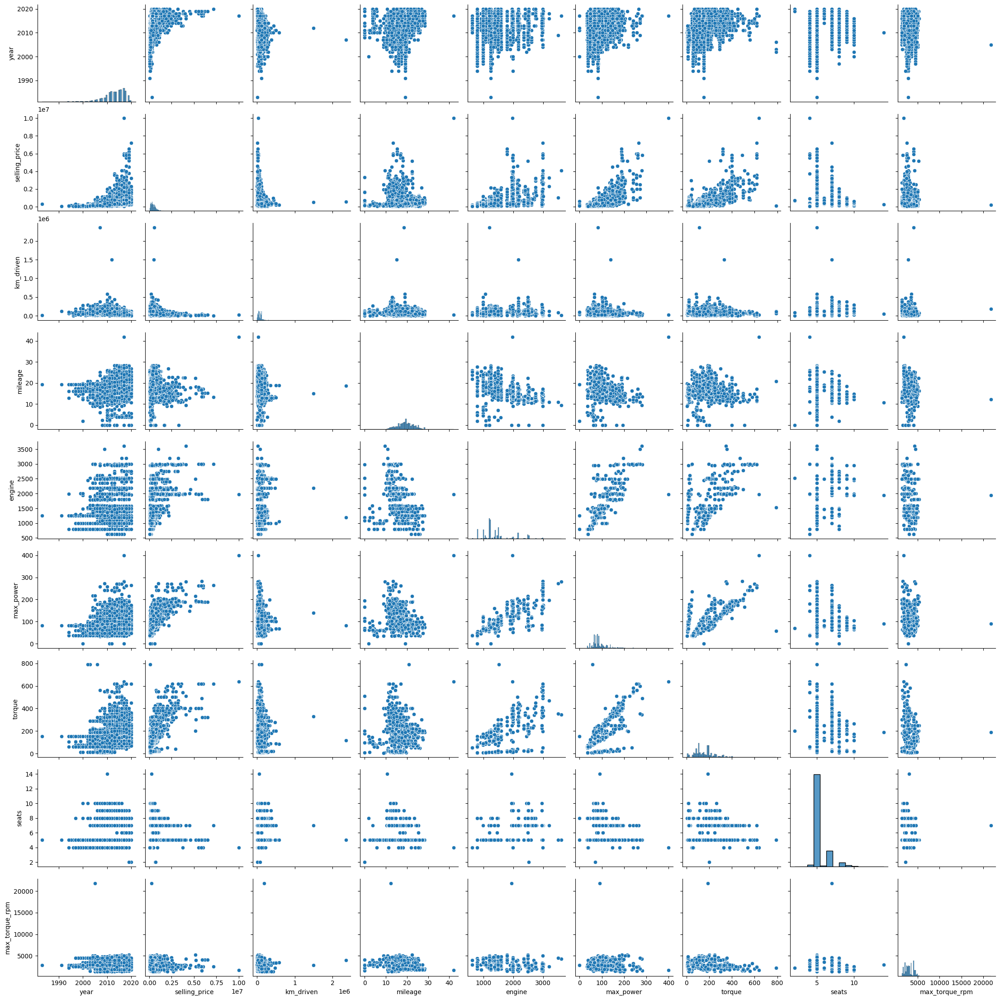

In [ ]:
sns.pairplot(df_train.select_dtypes(include=['int64', 'float64']))

> По графику видно, что selling_price связана с year, km_driven, engine, max_powerm torque. Но в случае с year и km_driven зависимость выглядит нелинейной

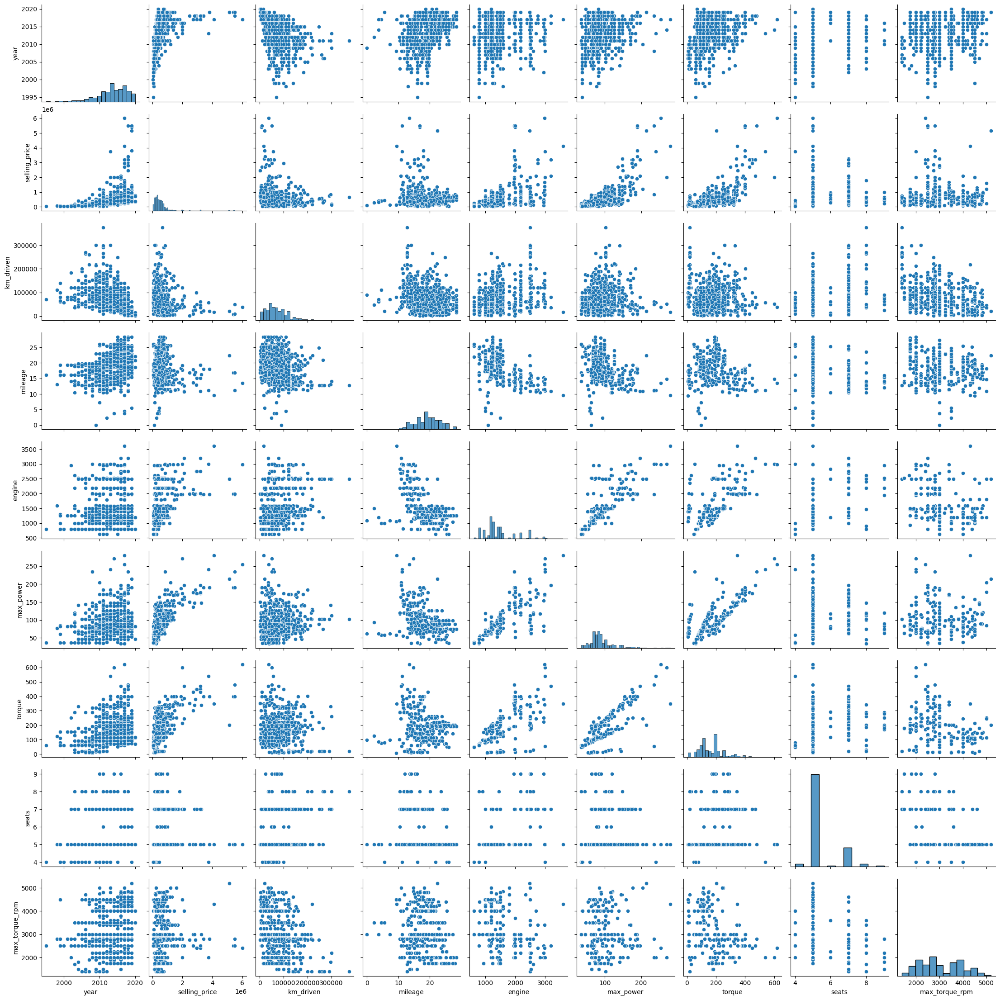

In [ ]:
sns.pairplot(df_test.select_dtypes(include=['int64', 'float64']))

> Зависимости те же, что были в трейне, разве что менее явные

### **Задание 9 (0.5 балла)**

И так, вы выдвинули гипотезы о наличии связи. Теперь давайте оценим эту связь в числах.

**Задание:**
- [ ] Получите значения коэффициента корреляции Пирсона для тренировочного набора данных при помощи `pd.corr()`
- [ ] По полученным корреляциям постройте тепловую карту (`heatmap` из бибилотеки seaborn)

In [30]:
corr_matrix = df_train.select_dtypes(include=['int64', 'float64']).corr()

In [31]:
def corr_vis(correlation_matrix):
  plt.figure(figsize=(8, 6))

  heatmap = sns.heatmap(correlation_matrix,
                      annot=True,
                      fmt='.2f',
                      cmap='coolwarm',
                      vmin=-1, vmax=1,
                      center=0,
                      square=True,
                      linewidths=2,
                      cbar_kws={'shrink': 0.8, 'label': 'Коэффициент корреляции'})
  plt.show()

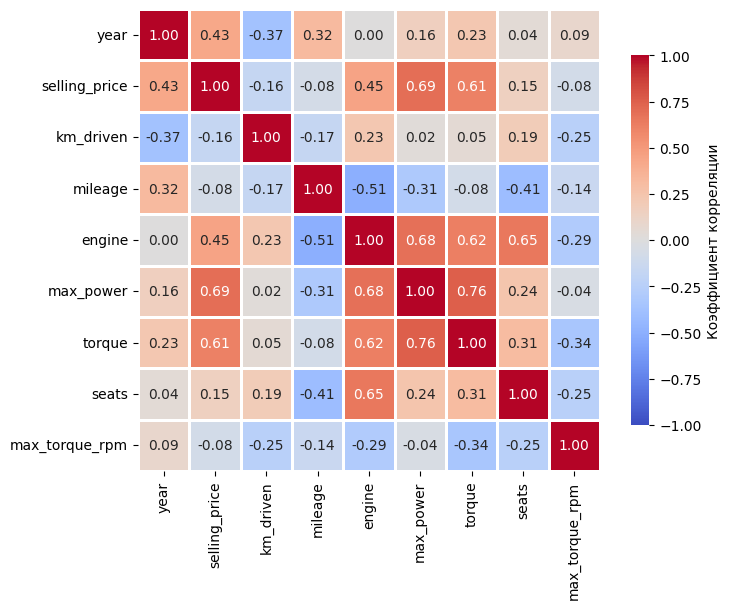

In [32]:
corr_vis(corr_matrix)

- [ ] Ответьте на вопросы:
 - Какие 2 признака наименее скоррелированы между собой?
 - Между какими наблюдается довольно сильная положительная линейная зависимость?
 - Правильно ли, опираясь на данные, утверждать, что чем меньше год, тем, скорее всего, больше километров проехала машина к дате продажи?
 - Изучите типы корреляций в `pd.corr()`. Какую вы использовали по умолчанию?

- Наименьшая корреляция между признаками: year & engine, km_driven & max_power
- Наибольшая положительная: max_power & torque, max_power & engine, engine & seats, engine & torque
- Коэффициент корреляции -0.37 достаточно небольшой, и не указывает на причинно-следственную связь. Вместо этого можно утверждать, что есть слабая тенденция: для более старых автомобилей характерен больший пробег, что логично, но это необязательно так
- По-умолчанию используется method='pearson'. Все методы:

   - pearson : standard correlation coefficient

   - kendall : Kendall Tau correlation coefficient

   - spearman : Spearman rank correlation

### **Задание 10 (0.6 балла)**

По умолчанию `pd.corr` возвращает корреляцию Пирсона, говорящую о линейной взаимосвязи. Но зависимости существуют не только линейные! В этой задаче, попробуйте измерить другие способы вычисления корреляций.

- [ ] Реализуйте корреляцию Спирмена/Кендала (на выбор) без использования библиотек (можно пользоваться только `numpy`). Сравните результаты вычисления с библиотечной реализацией
- [ ] Сделайте выводы


Постройте матрицу корреляции [phik](https://pypi.org/project/phik/)
- [ ] Проинтерпретируйте результаты


In [33]:
def compute_ranks(col):
    # Сортируем данные и берем индексы
    sorted_indices = np.argsort(col)
    # Рассчитываем ранги
    ranks = np.zeros_like(sorted_indices)
    ranks[sorted_indices] = np.arange(len(col)) # Например, самый маленький элемент с индексом 4, и ему будет соответствовать ранг 0. Тогда на 4 индексе значение 0

    unique_vals, inverse, counts = np.unique(col, return_inverse=True, return_counts=True)

    for i, count in enumerate(counts):
      if count >=2:
        # Ищем одинаковые числа и присваиваем им средний ранг
        mean_rank = ranks[inverse == i].mean()
        ranks[inverse == i] = mean_rank

    return ranks

def spearman_corr_manual(x ,y):
  x_ranks = compute_ranks(x)
  y_ranks = compute_ranks(y)

  x_mean_rank = x_ranks.mean()
  y_mean_rank = y_ranks.mean()

  numerator = np.sum((x_ranks - x_mean_rank) * (y_ranks - y_mean_rank))
  denominator = np.sqrt(np.sum((x_ranks - x_mean_rank)**2) * np.sum((y_ranks - y_mean_rank)**2))

  if denominator == 0:
    corr_spearman = 0
  else:
    corr_spearman = numerator/denominator

  return corr_spearman


In [34]:
numeric_columns = df_train.select_dtypes(include=['int64', 'float64']).columns
numeric_data = df_train[numeric_columns]
n = len(numeric_columns)
corr_matrix_sm = np.eye(n)

for i in range(n):
    for j in range(i + 1, n):
        x = numeric_columns[i]
        y = numeric_columns[j]

        corr_sm = spearman_corr_manual(numeric_data[x].values, numeric_data[y].values)

        corr_matrix_sm[i, j] = corr_sm
        corr_matrix_sm[j, i] = corr_sm

corr_matrix_sm = pd.DataFrame(corr_matrix_sm,
                             index=numeric_columns,
                             columns=numeric_columns)

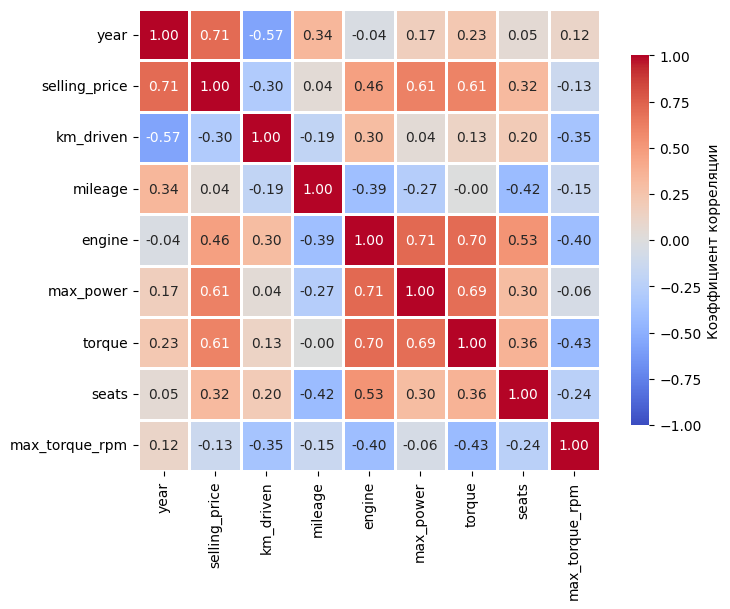

In [35]:
corr_vis(corr_matrix_sm)

In [36]:
library_corr_sm = df_train.select_dtypes(include=['int64', 'float64']).corr(method='spearman')

In [37]:
round(corr_matrix_sm-library_corr_sm, 3)

,year,selling_price,km_driven,mileage,engine,max_power,torque,seats,max_torque_rpm
year,0.0,-0.0,0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0
selling_price,-0.0,0.0,0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0
km_driven,0.0,0.0,0.0,0.0,-0.0,-0.0,0.0,0.0,0.0
mileage,-0.0,-0.0,0.0,0.0,-0.0,0.0,0.0,0.0,0.0
engine,0.0,0.0,-0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0
max_power,0.0,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0
torque,0.0,-0.0,0.0,0.0,-0.0,-0.0,0.0,-0.0,-0.0
seats,-0.0,-0.0,0.0,0.0,-0.0,-0.0,-0.0,0.0,-0.0
max_torque_rpm,-0.0,-0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0,0.0


> Ручная и библиотечная реализации дают идентичные результаты

In [38]:
phik_matrix = df_train.phik_matrix()

interval columns not set, guessing: ['year', 'selling_price', 'km_driven', 'mileage', 'engine', 'max_power', 'torque', 'seats', 'max_torque_rpm']


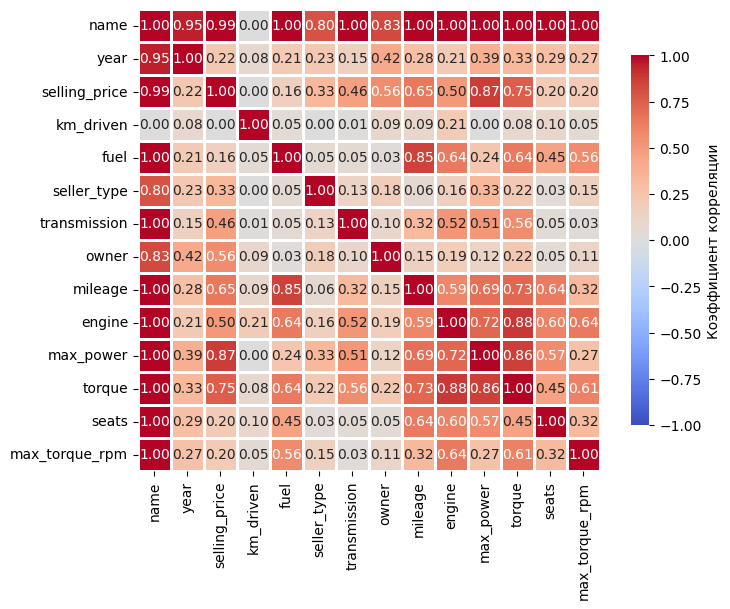

In [39]:
corr_vis(phik_matrix)

- Появились достаточно странные корреляции:
  - Корреляция selling_price & year упала
  - Корреляция selling_price & km_deiven = 0

- Высокие корреляции с selling_price:
  - max_power 0.87
  - torque 0.75
  - mileage 0.65

- Высокие корреляции между признаками:
  - engine & torque 0.88
  - max_power & torque 0.86
  - fuel & mileage 0.85
  - torque & mileage 0.73


In [40]:
phik_matrix_num = df_train.select_dtypes(include=['int64', 'float64']).phik_matrix()

interval columns not set, guessing: ['year', 'selling_price', 'km_driven', 'mileage', 'engine', 'max_power', 'torque', 'seats', 'max_torque_rpm']


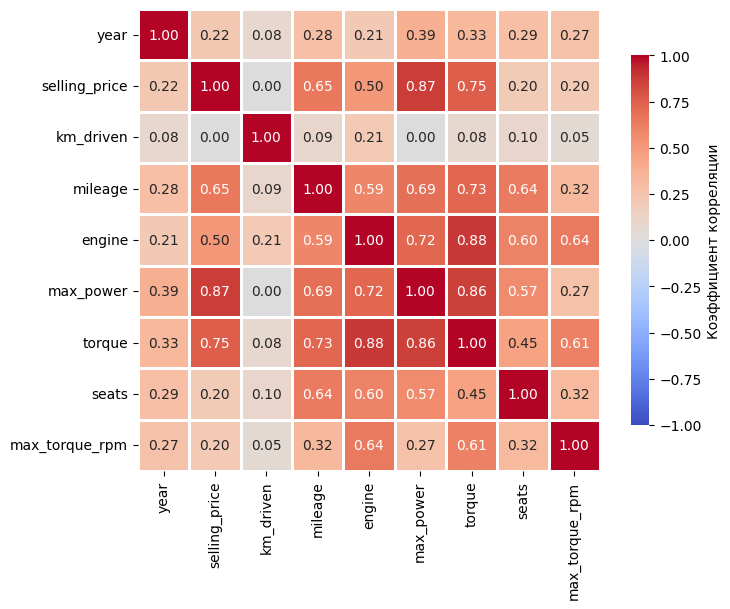

In [41]:
# Без категориальных в целом то же самое
corr_vis(phik_matrix_num)

> Неожиданно, что связь selling_price с пробегом и годом значительно снизились. остальные коэффициенты корреляции выросли

### **Дополнительные визуализации (бонус 0.25 балла)**

Если вам кажется, что мы не попросили вас нарисовать какие-то очень важные зависимости, нарисуйте их и поясните.
Один график: 0.125 балла, при условии, что он обоснован.

In [42]:
cat_columns = df_train.select_dtypes(include=['object']).columns
num_columns = df_train.drop('selling_price', axis=1).select_dtypes(include=['int64', 'float64']).columns

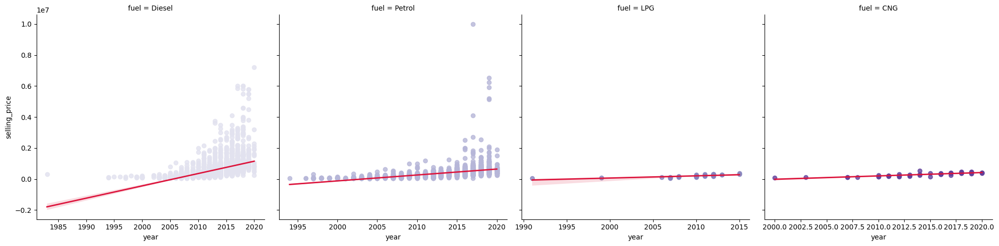

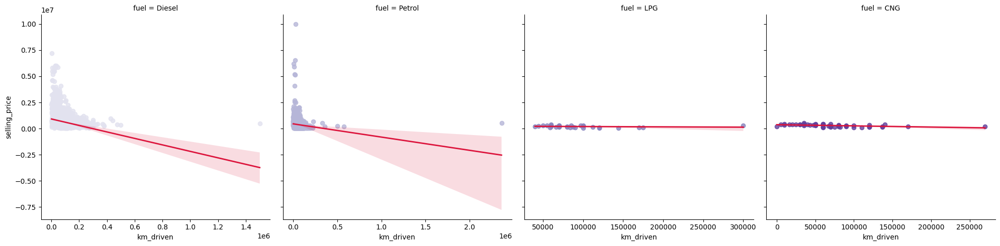

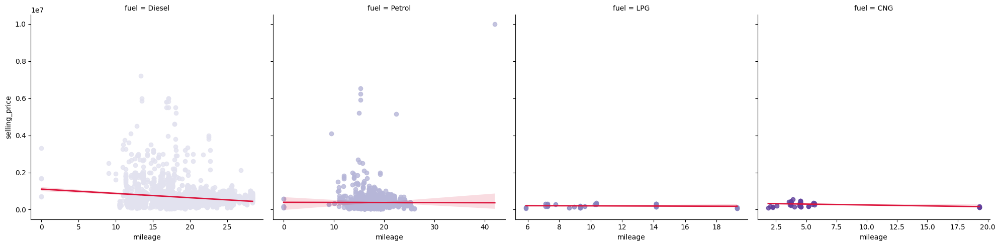

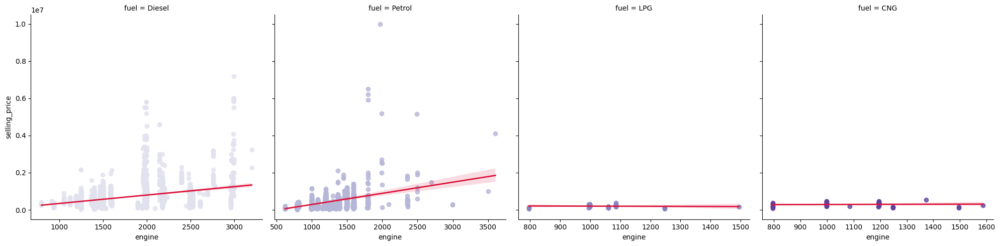

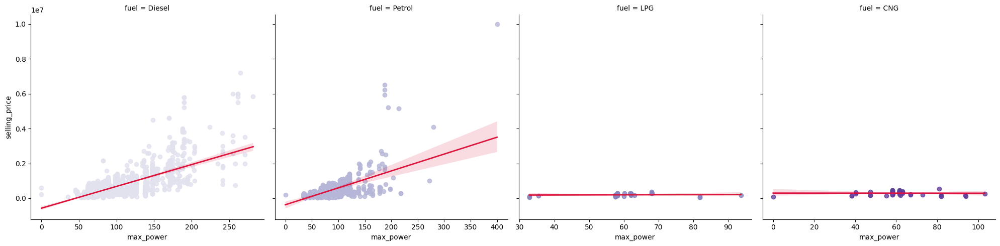

...

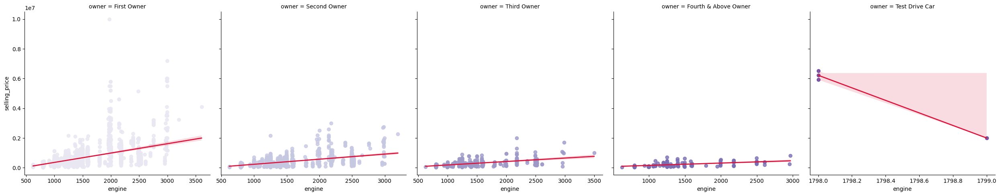

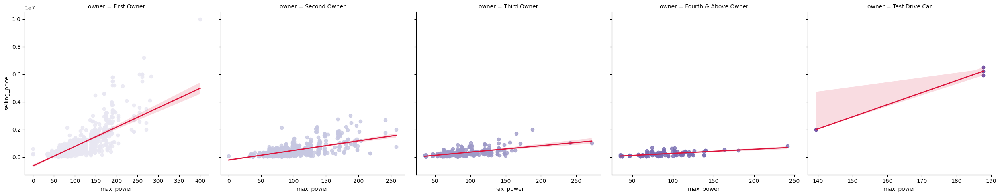

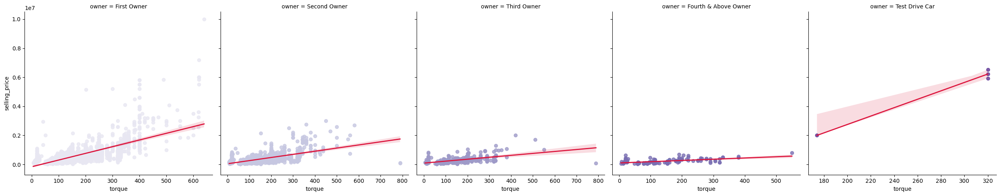

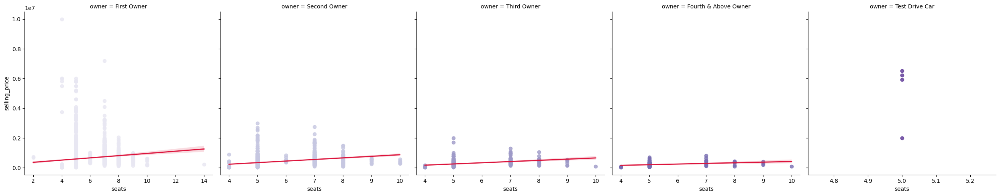

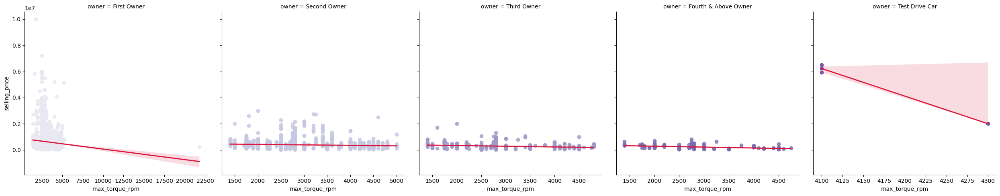

In [43]:
for cat_col in cat_columns[1:]:
  for column in num_columns:
    sns.lmplot(
        data=df_train,
        x=column,
        y="selling_price",
        col=cat_col,
        hue=cat_col,
        facet_kws={'sharey': True, 'sharex': False},
        line_kws={'color': 'crimson', 'lw': 2},
        palette = "Purples"
    )

    plt.show()

> Видно, что для каких то категорий сложнее предсказать цену, чем для других (например, если у авто было больше одного владельца, линия регрессии становится пологой).

# **Часть 2 (1.7 балла) | Модель только на вещественных признаках**

В этой части вам предстоит обучить модель только на вещественных признаках. Почему только на них?

Чем больше признаковое пространство — чем сложнее модель. А чем модель проще — тем лучше для скорости работы и интерпретации признаков.

За задания этой части вы можете набрать 1.7 основных и 0.15 бонусных балла;

### **Задание 11 (0.05 балла)**

Разбейте данные на тренировочный и тестовый наборы. Перед разбиением создайте копию датафрейма, который будет хранить только вещественные признаки и используйте его (то есть категориальные столбцы (все, кроме seats) необходимо удалить).

В переменные y_train и y_test запишите значения целевых переменных.

In [44]:
df_train_num = df_train.select_dtypes(include=['int64', 'float64']).copy()

In [45]:
y_train = df_train_num['selling_price']
X_train = df_train_num.drop('selling_price', axis=1)

In [46]:
y_test = df_test['selling_price']
X_test = df_test.drop('selling_price', axis=1)

#### Описание вещественных признаков:
- year: год
- km_driven: пробег в километрах
- mileage: расход топлива (километры на литр)
- engine: объем двигателя в кубических сантиметрах
- max_power: максимальная мощность в лошадинных силах
- torque: крутящий момент в Ньютон-метрах
- seats: количество мест
- max_torque_rpm: обороты максимального крутящего момента в оборотах в минуту

### **Задание 12. (0.2 балла)**

Построим нашу первую модель!
- [ ] Обучите классическую линейную регрессию с дефолтными параметрами. Посчтитайте $R^2$ и $MSE$ для трейна и для теста.
- [ ] Сделайте выводы по значениям метрик качества.

**Примечание:**

Здесь и далее $R^2$ и $MSE$ для трейна и для теста выводите везде, где требуется обучать модели, даже если в явном виде этого не просят. Иначе непонятно, как понять, насколько успешны наши эксперименты.

In [56]:
lr = LinearRegression()
lr.fit(X_train, y_train)

y_test_pred_lr = lr.predict(X_test[num_columns])
y_train_pred_lr = lr.predict(X_train[num_columns])

In [57]:
print(f"R2 на трейне: {r2_score(y_train, y_train_pred_lr)}")
print(f"MSE на трейне: {MSE(y_train, y_train_pred_lr)}")

print(f"\nR2 на тесте: {r2_score(y_test, y_test_pred_lr)}")
print(f"MSE на тесте: {MSE(y_test, y_test_pred_lr)}")

R2 на трейне: 0.6027010498483751
MSE на трейне: 113881110902.79457

R2 на тесте: 0.6017248835858344
MSE на тесте: 228939909915.08807


- Достаточно неплохой R2, причем разница между train и test ~0.01.
- Нет переобучения
- Огромный MSE, причем на тесте в два раза больше

### **Задание 13 (0.15 балла)**

- [ ] Реализуйте $R^2$ руками. Приведите формулу $R^2$ и объясните каждую компоненту метрики

In [52]:
def r2_score_manual(y_true, y_pred):
  y_true = np.array(y_true)
  y_pred = np.array(y_pred)

  SSR = np.sum((y_pred - y_true.mean()) ** 2) # Насколько предсказания модели отличаются от среднего
  SST = np.sum((y_true - y_true.mean()) ** 2) # Общий разброс данных вокруг среднего

  return SSR / SST if SST != 0 else 0

### **Бонус (0.15 балла)**

- [ ] Реализуйте [$\text{adjusted}-R^2$](https://en.wikipedia.org/wiki/Coefficient_of_determination).
- [ ] Объясните, когда применяется $\text{adjusted}-R^2$?

In [53]:
def r2_score_adjusted_manual(y_true, y_pred, num_features):
  sample_size = len(y_true)
  r2_score = r2_score_manual(y_true, y_pred)

  if sample_size - num_features < 1:
    return r2_score

  return 1 - ((1 - r2_score) * (sample_size - 1) / (sample_size - num_features - 1))

> Обычный R2 растет всегда при добавлении признаков. Adjusted R2 "штрафует" за избыточные признаки. Поэтому, если нужно понять, насколько новые признаки улучшают модель, нужно использовать Adjusted R2.



### **Задание 14 (0.05 балла)**

Всегда есть место совершенству. Поэтому давайте попробуем улучшить модель. При помощи стандартизации признаков.

- [ ] Стандартизируйте значения в тренировочных и тестовых данных. Стандартизатор **обучайте только на `train`**.

In [58]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test[num_columns])

In [59]:
X_train_scaled = pd.DataFrame(X_train_scaled, columns=num_columns, index=y_train.index)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=num_columns, index=y_test.index)

In [60]:
lr.fit(X_train_scaled, y_train)

y_test_pred_lr_scaled = lr.predict(X_test_scaled[num_columns])
y_train_pred_lr_scaled = lr.predict(X_train_scaled[num_columns])

In [61]:
print(f"R2 на трейне: {r2_score(y_train, y_train_pred_lr_scaled)}")
print(f"MSE на трейне: {MSE(y_train, y_train_pred_lr_scaled)}")
print(f"\nR2 на тесте: {r2_score(y_test, y_test_pred_lr_scaled )}")
print(f"MSE на тесте: {MSE(y_test, y_test_pred_lr_scaled )}")

R2 на трейне: 0.6027010498483734
MSE на трейне: 113881110902.79507

R2 на тесте: 0.6017248835858423
MSE на тесте: 228939909915.08356


### **Задание 15 (0.1 балла)**

Хотя стандартизация не помогла сильно прибавить в качестве она открыла возможность интерпретировать важность признаков в модели. Правило интерпретации такое:

Чем больше коэффициент $\beta_i$ по модулю, тем важнее признак.

**Ответьте на вопрос:**

- [ ] Какой признак оказался наиболее информативным в предсказании цены?

In [62]:
pd.DataFrame({'feature': num_columns, 'coef': lr.coef_}).sort_values(by='coef', key=np.abs, ascending=False)

,feature,coef
4,max_power,302230.256147
0,year,163854.623247
7,max_torque_rpm,-51876.553775
1,km_driven,-50056.472713
5,torque,46098.083414
6,seats,-33990.739145
2,mileage,-19547.608554
3,engine,13402.478775


> max_power наиболее информативный

### **Задание 16 (0.25 балла)**

Попробуем улучшить нашу модель с помощью применения регуляризации. Для этого воспльзуемся `Lasso` регрессией.  Кроме того, попробуйте использовать её теоретическое свойство отбора признаков, за счет зануления незначимых коэффициентов.

**Задание:**

- [ ] Обучите Lasso регрессию на тренировочном наборе данных с нормализованными признаками. Оцените её качество
- [ ] Проверьте, занулила ли L1-регуляризация с параметрами по умолчанию какие-нибудь веса? Предположите почему.

In [63]:
lasso = Lasso()
lasso.fit(X_train_scaled, y_train)

y_train_pred_lasso_default = lasso.predict(X_train_scaled)
y_test_pred_lasso_default = lasso.predict(X_test_scaled)

In [64]:
print(f"R2 на трейне: {r2_score(y_train, y_train_pred_lasso_default)}")
print(f"MSE на трейне: {MSE(y_train, y_train_pred_lasso_default)}")
print(f"\nR2 на тесте: {r2_score(y_test, y_test_pred_lasso_default)}")
print(f"MSE на тесте: {MSE(y_test, y_test_pred_lasso_default)}")

R2 на трейне: 0.6027010498023324
MSE на трейне: 113881110915.99217

R2 на тесте: 0.6017235425356218
MSE на тесте: 228940680789.0449


In [65]:
pd.DataFrame({'feature': num_columns, 'coef': lasso.coef_}).sort_values(by='coef', key=np.abs, ascending=False)

,feature,coef
4,max_power,302231.119129
0,year,163852.639614
7,max_torque_rpm,-51874.384474
1,km_driven,-50055.449069
5,torque,46097.943149
6,seats,-33986.949745
2,mileage,-19544.731742
3,engine,13400.402635


> Коэффициенты не занулились. Возможно alpha=0.1 слишком мало

### **Задание 17. Финальный рывок (0.4 балла)**

До этого мы с вами использовали `train` для обучения и `test` для прогнозирования. Но у нас есть ещё одна задача — подобрать оптимальные параметры модели. Для этого используем кросс-валидацию, описанную на семинарах.

Кроме того, выжмем максимум из модификаций регрессии. Построим `ElasticNet`. И сделаем всё по порядку.

**Ваша задача 1:**

- [ ] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для Lasso-регрессии. Вам пригодится класс [GridSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html).
- [ ] Ответьте на вопросы:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Что значит каждый параметр `param_grid`, который вы заполняли для `GridSearch`? Опишите каждый
 - Какой коэффициент регуляризации у лучшей из перебранных моделей? Занулились ли какие-нибудь из весов при такой регуляризации?

In [71]:
param_grid = {
    'alpha': np.logspace(-1, 3, 20), # Коэффициент регуляризации, насколько сильно нам важен отбор и норма весов
    'max_iter': [100, 1000, 5000] # Максимальное количество итераций алгоритма оптимизации для минимизации функции потерь
}

lasso_grid = GridSearchCV(
    Lasso(),
    param_grid,
    cv=10,
    n_jobs=-1,
    verbose=1
)

lasso_grid.fit(X_train_scaled, y_train)

Fitting 10 folds for each of 60 candidates, totalling 600 fits


GridSearchCV(cv=10, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': array([1.00000000e-01, 1.62377674e-01, 2.63665090e-01, 4.28133240e-01,
       6.95192796e-01, 1.12883789e+00, 1.83298071e+00, 2.97635144e+00,
       4.83293024e+00, 7.84759970e+00, 1.27427499e+01, 2.06913808e+01,
       3.35981829e+01, 5.45559478e+01, 8.85866790e+01, 1.43844989e+02,
       2.33572147e+02, 3.79269019e+02, 6.15848211e+02, 1.00000000e+03]),
                         'max_iter': [100, 1000, 5000]},
             verbose=1)

In [72]:
best_params = lasso_grid.best_params_
print(f"alpha: {best_params['alpha']}")
print(f"max_iter: {best_params['max_iter']}")
print(f"R2: {lasso_grid.best_score_:.2f}")

alpha: 1000.0
max_iter: 100
R2: 0.58


>

In [73]:
print('Столько моделей было обучено:')
len(param_grid['alpha'])*len(param_grid['max_iter'])*10

Столько моделей было обучено:


600

In [74]:
pd.DataFrame({'feature': num_columns, 'coef': lasso_grid.best_estimator_.coef_})

,feature,coef
0,year,161879.915208
1,km_driven,-49020.865220
2,mileage,-16709.210831
3,engine,11201.911251
4,max_power,303159.195453
5,torque,45949.086214
6,seats,-30161.140159
7,max_torque_rpm,-49737.248083


> Ни один из весов не занулился

In [75]:
lasso = Lasso(alpha=best_params['alpha'], max_iter=best_params['max_iter'])
lasso.fit(X_train_scaled, y_train)

y_train_pred_lasso = lasso.predict(X_train_scaled)
y_test_pred_lasso = lasso.predict(X_test_scaled)

print(f"R2 на трейне: {r2_score(y_train, y_train_pred_lasso)}")
print(f"MSE на трейне: {MSE(y_train, y_train_pred_lasso)}")
print(f"\nR2 на тесте: {r2_score(y_test, y_test_pred_lasso)}")
print(f"MSE на тесте: {MSE(y_test, y_test_pred_lasso)}")

R2 на трейне: 0.6026547415940806
MSE на трейне: 113894384623.85782

R2 на тесте: 0.6003609462353132
MSE на тесте: 229723940052.2695


**Ваша задача 2:**

- [ ] Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для [ElasticNet](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html) регрессии.
- [ ] Ответьте на вопрос:
 - Сколько грид-сёрчу пришлось обучать моделей?
 - Какие гиперпараметры соответствуют лучшей (по выбранной метрике качества) из перебранных моделей?

In [76]:
param_grid_EN = {
    'alpha': [0.1, 1.0, 10, 100, 1000],
    'l1_ratio': [0.0, 0.3, 0.5, 0.7, 0.9, 1.0],
    'max_iter': [1000, 5000, 10000]
}

elastic_grid = GridSearchCV(
    ElasticNet(),
    param_grid_EN,
    cv=10,
    n_jobs=-1,
    verbose=1
)

elastic_grid.fit(X_train_scaled, y_train)

best_params_elastic = elastic_grid.best_params_
print(f"alpha: {best_params_elastic['alpha']}")
print(f"l1_ratio: {best_params_elastic['l1_ratio']}")
print(f"max_iter: {best_params_elastic['max_iter']}")
print(f"R2: {elastic_grid.best_score_:.6f}")

Fitting 10 folds for each of 90 candidates, totalling 900 fits
alpha: 1.0
l1_ratio: 0.9
max_iter: 1000
R2: 0.583297


In [77]:
print('Столько моделей было обучено:')
len(param_grid_EN['alpha'])*len(param_grid_EN['max_iter'])*len(param_grid_EN['l1_ratio'])*10

Столько моделей было обучено:


900

In [78]:
EN = ElasticNet(alpha=best_params_elastic['alpha'], max_iter=best_params_elastic['max_iter'], l1_ratio=best_params_elastic['l1_ratio'])
EN.fit(X_train_scaled, y_train)

y_train_pred_EN = EN.predict(X_train_scaled)
y_test_pred_EN = EN.predict(X_test_scaled)

print(f"R2 на трейне: {r2_score(y_train, y_train_pred_EN)}")
print(f"MSE на трейне: {MSE(y_train, y_train_pred_EN)}")
print(f"\nR2 на тесте: {r2_score(y_test, y_test_pred_EN)}")
print(f"MSE на тесте: {MSE(y_test, y_test_pred_EN)}")

R2 на трейне: 0.5976878998546595
MSE на трейне: 115318071886.93202

R2 на тесте: 0.5811462553462932
MSE на тесте: 240769093063.04413


### **Задание 18 (0.35 балла)**

И так, вы обучили все варианты регуляризаций, доступные в sklearn, но не все, что мы обсудили на занятии! И следующее задание о забытой - $L0$ регуляризации.


**Ваша задача:**>
- [ ] Реализуйте модель с $L0$-регуляризаицей.
- [ ] Обучите модель на данных и проанализируйте результат, экспериментируя с коэффициенитом регуляризации
- [ ] Проанализируйте результаты обучения

**Важно:**

Вопреки тому, что L0 не реализована в стандартных пакетах, концепция данной регуляризации не является мертвой. Она может встречаться в [статьях](https://arxiv.org/abs/1712.01312) и экспериментах.



In [ ]:
-

# **Часть 3 (0.5 балла) | Добавляем категориальные фичи**

Попробуем для улучшения модели дать ей больше признаков. Добавим категориальные фичи.

За эту часть можно набрать 0.5 основных балла.



### **Задание 19 (0.1 балла)**

Проанализируйте столбец `name`. Очевидно, что эта переменная является категориальной, однако категорий в ней много.

- [ ] Предобработайте столбец `name`, чтобы избежать его удаления

In [79]:
X_train_scaled_cat = pd.concat([X_train_scaled, df_train[cat_columns]], axis=1)

In [80]:
X_test_scaled_cat = pd.concat([X_test_scaled, df_test[cat_columns]], axis=1)

In [81]:
X_train_scaled_cat.describe(include='object')

,name,fuel,seller_type,transmission,owner
count,5840,5840,5840,5840,5840
unique,1924,4,3,2,5
top,Maruti Swift Dzire VDI,Diesel,Individual,Manual,First Owner
freq,91,3177,5223,5336,3603


In [82]:
print(f"Уникальных названий (категорий): {df_train['name'].nunique()}")
print(f"Всего объектов: {len(df_train)}")

# Посмотрим на самые частые названия
top_names = df_train['name'].value_counts().head(20)
print(f"Самые частые категории:")
for name in top_names.index:
    print(name)

Уникальных названий (категорий): 1924
Всего объектов: 5840
Самые частые категории:
Maruti Swift Dzire VDI
Maruti Alto 800 LXI
Maruti Alto LXi
Maruti Swift VDI
Maruti Swift VDI BSIV
Maruti Alto K10 VXI
Maruti Ertiga VDI
Hyundai EON Era Plus
Maruti Swift Dzire VXI
Maruti Alto LX
Maruti Ritz VDi
Maruti Wagon R VXI BS IV
Maruti 800 AC
Maruti Swift Dzire VDi
Ford Figo Diesel Titanium
Renault KWID RXT
Mahindra XUV500 W6 2WD
Maruti Alto K10 2010-2014 VXI
Hyundai EON Magna Plus
Hyundai Santro Xing GLS


> Можно выделить категорию из первого слова: названия бренда

In [83]:
# 30 категорий уже достаточно много, поэтому возьмем только 1 слово в строке
df_train['name'].str.split().str[0].nunique(), df_train['name'].str.split().str[1].nunique(), df_train['name'].str.split().str[2].nunique()

(30, 202, 335)

In [84]:
X_train_scaled_cat['name'] = X_train_scaled_cat['name'].str.split().str[0]
X_test_scaled_cat['name'] = X_test_scaled_cat['name'].str.split().str[0]

### **Задание 20 (0.1 балла)**

- [ ] Закодируйте категориалльные фичи и ``seats`` методом OneHot-кодирования.

In [86]:
onehot_encoder = OneHotEncoder(sparse_output=False, drop='first', handle_unknown='ignore')

X_train_scaled_encoded = onehot_encoder.fit_transform(df_train[cat_columns])
X_test_scaled_encoded = onehot_encoder.transform(df_test[cat_columns])

X_train_scaled_encoded = pd.DataFrame(
    X_train_scaled_encoded,
    columns=onehot_encoder.get_feature_names_out(cat_columns),
    index=df_train.index
)

X_test_scaled_encoded = pd.DataFrame(
    X_test_scaled_encoded,
    columns=onehot_encoder.get_feature_names_out(cat_columns),
    index=df_test.index
)

In [87]:
X_train_scaled_encoded  = pd.concat([X_train_scaled_encoded, X_train_scaled], axis=1)

In [88]:
X_test_scaled_encoded  = pd.concat([X_test_scaled_encoded, X_test_scaled], axis=1)

### **Задание 21 (0.2 балла)**

OHE — базовый алгоритм преобразования категориальных признаков, но и с ним нужно быть аккуратными.

**Ответьте на вопросы:**


* Как корректно работать с OHE преобразованием?
* Почему мы удаляем один столбец?
* Пусть из $n$ признаков мы получили $n-1$ столбец, из которых $k < n -1$ оказались не важными по весам модели. Корректно ли их удалить?

- Нужно выбрасывать 1 из колонок для категории
- Иначе информация избыточна и возникает мультиколлинерность
- Нельзя удалять неважные признаки. Иначе меняется "базовая категория". Изначально базовая категория эта та, что мы выкинули при кодировании. После удаления интерпретация поменяется

### **Задание 22 (0.1 балла)**
Повторим то, что делали на прошлом шаге для моделей на вещественных признаках, однако теперь с моделью `Ridge`.


**Ваша задача:**
- [ ] Переберите параметр регуляризации `alpha` для гребневой (ridge) регрессии с помощью класса `GridSearchCV` В качестве параметров при объявлении GridSearchCV кроме модели укажите метрику качества $R^2$. Кроссвалидируйтесь по 10-ти фолдам.
- [ ] Ответье на вопрос: Удалось ли улучшить качество прогнозов?

In [89]:
param_grid_ridge = {
    'alpha': np.logspace(-3, 3, 50)
}

ridge_grid = GridSearchCV(
    Ridge(),
    param_grid_ridge,
    cv=10,
    scoring='r2',
    n_jobs=-1,
    verbose=1
)

ridge_grid.fit(X_train_scaled_encoded, y_train)

Fitting 10 folds for each of 50 candidates, totalling 500 fits


GridSearchCV(cv=10, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': array([1.00000000e-03, 1.32571137e-03, 1.75751062e-03, 2.32995181e-03,
       3.08884360e-03, 4.09491506e-03, 5.42867544e-03, 7.19685673e-03,
       9.54095476e-03, 1.26485522e-02, 1.67683294e-02, 2.22299648e-02,
       2.94705170e-02, 3.90693994e-02, 5.17947468e-02, 6.86648845e-02,
       9.10298178e-02, 1.20679264e-01, 1.5998...
       2.68269580e+00, 3.55648031e+00, 4.71486636e+00, 6.25055193e+00,
       8.28642773e+00, 1.09854114e+01, 1.45634848e+01, 1.93069773e+01,
       2.55954792e+01, 3.39322177e+01, 4.49843267e+01, 5.96362332e+01,
       7.90604321e+01, 1.04811313e+02, 1.38949549e+02, 1.84206997e+02,
       2.44205309e+02, 3.23745754e+02, 4.29193426e+02, 5.68986603e+02,
       7.54312006e+02, 1.00000000e+03])},
             scoring='r2', verbose=1)

In [90]:
R = Ridge(alpha=ridge_grid.best_params_['alpha'])
R.fit(X_train_scaled_encoded, y_train)

y_train_pred_R = R.predict(X_train_scaled_encoded)
y_test_pred_R = R.predict(X_test_scaled_encoded)

print(f"R2 на трейне: {r2_score(y_train, y_train_pred_R)}")
print(f"MSE на трейне: {MSE(y_train, y_train_pred_R)}")
print(f"\nR2 на тесте: {r2_score(y_test, y_test_pred_R)}")
print(f"MSE на тесте: {MSE(y_test, y_test_pred_R)}")

R2 на трейне: 0.9676740263237786
MSE на трейне: 9265863380.35288

R2 на тесте: 0.941535984050607
MSE на тесте: 33606785845.012573


- R2 значительно возрос. Но 97% для трейна выглядит нереалистично высоким.
- MSE на тесте в 3 раза больше, чем на трейне

# **Часть 4 - бонусная (1 балл) | Feature Engineering**

В этой части домашнего задания вам предлагается проявить свою креативность для улучшения прогноза модели. Любые другие модели, кроме различных форм линейной (или полиномиальной) регресси, использовать запрещается. А значит, придется работать с признаками

**Что можно попробовать сделать?** (каждый пункт по 0.4 балла, но не больше 1-х балла в сумме)

1.   *Сгенерировать новые признаки на основе уже существующих:*
    * посчитать произведения // частные признаков (кажется, что посчитать число "лошадей" на литр объема может быть полезно);
    * имеет смысл обратить внимание на визуализации в части с EDA (к примеру, зависимость цены от года выглядит квадратичной, а не линейной; значит, квадрат года нам, скорее всего, принесет больше пользы)

2.   *Добыть новые признаки:*
    * имеем название автомобиля, которое никак не используем (можно спарсить инфу о классе автомобиля или каких-то специфических опциях)
    * можно добавить пороговые признаки вроде "владелец третий или больше" и объединить признаки в некоторые осмысленные правила, например "первый или второй владелец и продавец официальный дилер" (подбирать пороги удобно по диаграммам рассеяния)

3.   *Поработать с уже имеющимися:*
    * далеко не факт, что заполнить пропуск медианой было лучшей идеей (как минимум, можно добавить dummy-столбец для модели, сигнализирующий, что раньше на месте медианы был пропуск -- там где он был, конечно); попробуйте другие способы филлинга;
    * мы не анализировали, есть ли в данных выбросы => никак выбросы не обрабатывали; наиболее простым и, тем не менее, довольно полезным вариантом нахождения выбросов могут послужить boxplot'ы для каждого столбца; что делать с выбросами думайте сами :) -- вариантов довольно много
    * мы толком не смотрели на таргет сам по себе; в нем тоже могут быть неожиданности -- стоит хотя бы проверить
    * можно заметить, что некоторые признаки распределены совсем не нормально; возможно их стоит отлогарифмировать

И так далее...

Feel Free to Try!

#### 1.

> По ранее изученным графикам кажется, что имеет смысл добавить год и пробег в квадрате

In [94]:
X_train_scaled_encoded['km_driven_squared'] = X_train_scaled_encoded['km_driven'] ** 2
X_train_scaled_encoded['year_squared'] = X_train_scaled_encoded['year'] ** 2

X_test_scaled_encoded['km_driven_squared'] = X_test_scaled_encoded['km_driven'] ** 2
X_test_scaled_encoded['year_squared'] = X_test_scaled_encoded['year'] ** 2

In [116]:
# Модель для сравнения: Ridge
R_best = Ridge(alpha=ridge_grid.best_params_['alpha'])
R_best.fit(X_train_scaled_encoded, y_train)

y_train_pred_R_fe1 = R_best.predict(X_train_scaled_encoded)
y_test_pred_R_fe1 = R_best.predict(X_test_scaled_encoded)

print(f"R2 на трейне: {r2_score(y_train, y_train_pred_R_fe1)}")
print(f"MSE на трейне: {MSE(y_train, y_train_pred_R_fe1)}")
print(f"\nR2 на тесте: {r2_score(y_test, y_test_pred_R_fe1)}")
print(f"MSE на тесте: {MSE(y_test, y_test_pred_R_fe1)}")

R2 на трейне: 0.9699644558185279
MSE на трейне: 8609338475.852058

R2 на тесте: 0.9443045277871213
MSE на тесте: 32015347847.730186


- Модель стабильно улучшилась на всех метриках
- Переобучение уменьшилось (меньше разрыв трейн/тест)

#### 2.

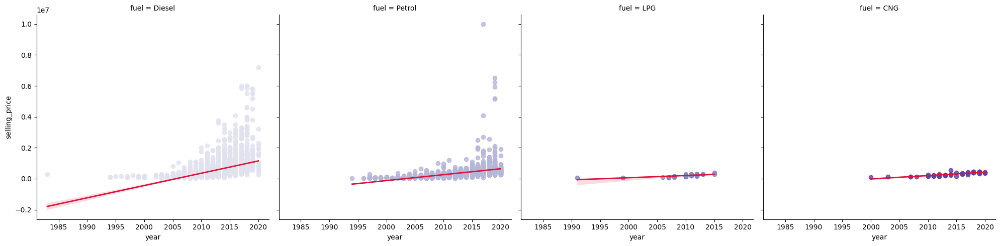

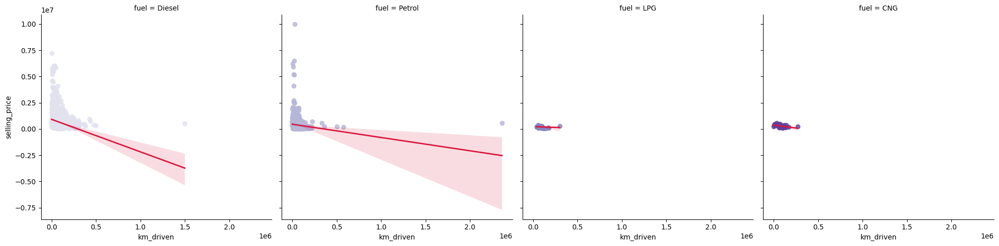

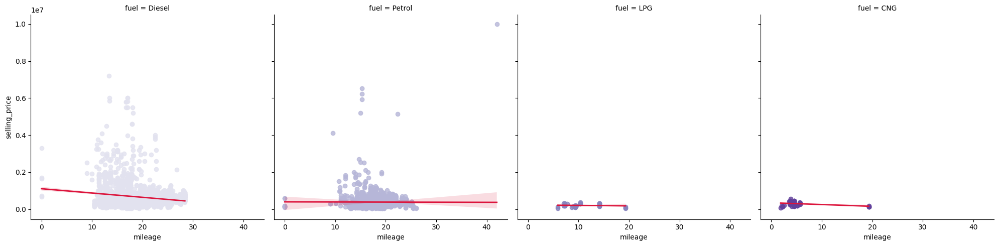

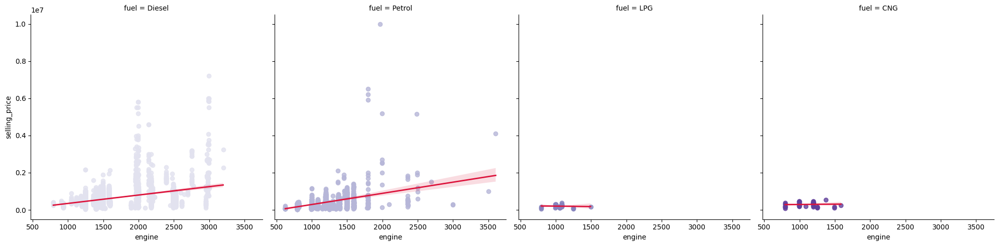

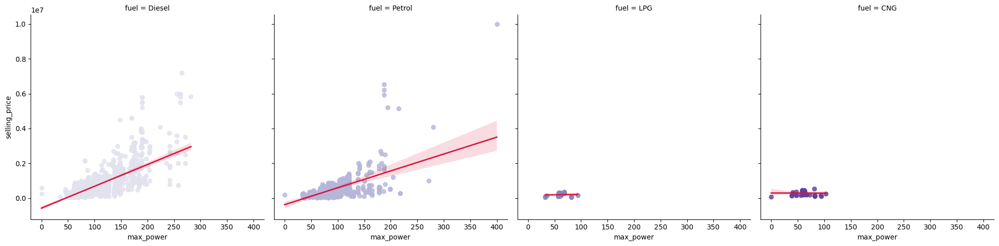

...

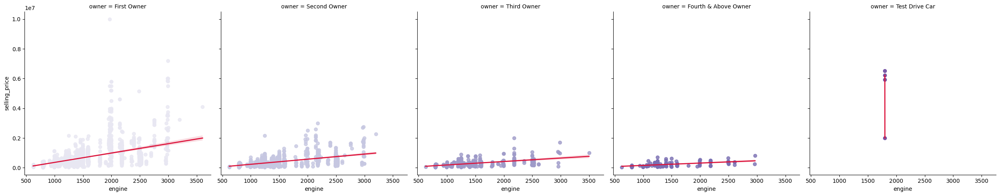

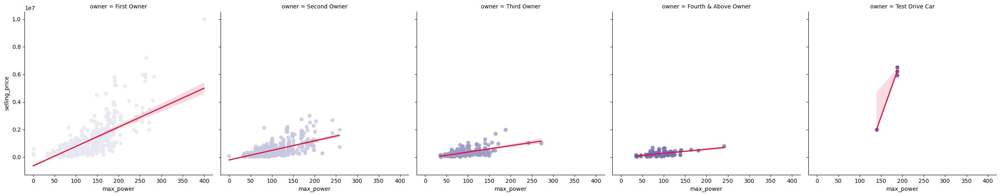

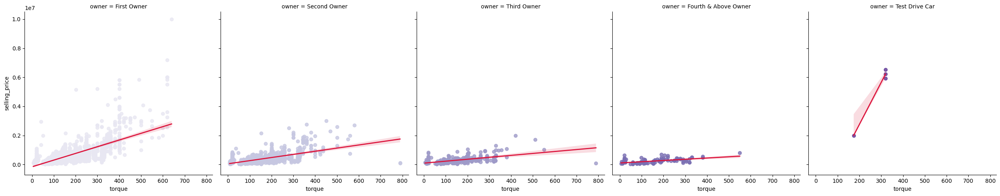

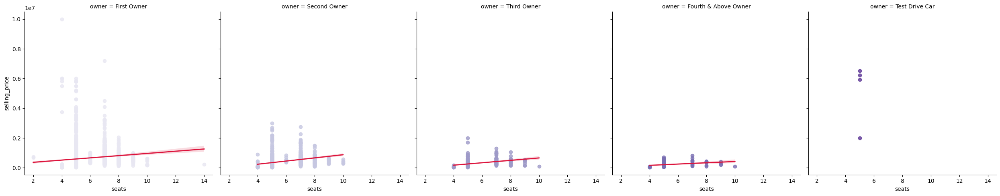

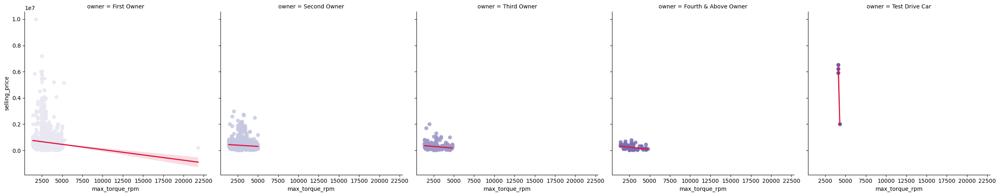

In [ ]:
for cat_col in cat_columns[1:]:
  for column in num_columns:
    sns.lmplot(
        data=df_train,
        x=column,
        y="selling_price",
        col=cat_col,
        hue=cat_col,
        facet_kws={'sharey': True, 'sharex': True},
        line_kws={'color': 'crimson', 'lw': 2},
        palette = "Purples"
    )

    plt.show()

> По графикам кажется, что имеет смысл добавить объединенные категории: LPG и CNG; 2+ владельца

In [98]:
X_train_scaled_encoded['fuel_gas'] = ((X_train_scaled_encoded['fuel_LPG'] == 1) | ((X_train_scaled_encoded['fuel_LPG'] == 0) & (X_train_scaled_encoded['fuel_Petrol'] == 0) & (X_train_scaled_encoded['fuel_Diesel'] == 0))).astype(int)

In [99]:
X_train_scaled_encoded['owner_Second_or_above'] = ((X_train_scaled_encoded['owner_Second Owner'] == 1) | (X_train_scaled_encoded['owner_Third Owner'] == 1) | (X_train_scaled_encoded['owner_Fourth & Above Owner'] == 1)).astype(int)

In [100]:
X_test_scaled_encoded['fuel_gas'] = ((X_test_scaled_encoded['fuel_LPG'] == 1) | ((X_test_scaled_encoded['fuel_LPG'] == 0) & (X_test_scaled_encoded['fuel_Petrol'] == 0) & (X_test_scaled_encoded['fuel_Diesel'] == 0))).astype(int)

In [101]:
X_test_scaled_encoded['owner_Second_or_above'] = ((X_test_scaled_encoded['owner_Second Owner'] == 1) | (X_test_scaled_encoded['owner_Third Owner'] == 1) | (X_test_scaled_encoded['owner_Fourth & Above Owner'] == 1)).astype(int)

In [102]:
# Модель для сравнения: Ridge
R = Ridge(alpha=ridge_grid.best_params_['alpha'])
R.fit(X_train_scaled_encoded, y_train)

y_train_pred_R_fe2 = R.predict(X_train_scaled_encoded)
y_test_pred_R_fe2 = R.predict(X_test_scaled_encoded)

print(f"R2 на трейне: {r2_score(y_train, y_train_pred_R_fe2)}")
print(f"MSE на трейне: {MSE(y_train, y_train_pred_R_fe2)}")
print(f"\nR2 на тесте: {r2_score(y_test, y_test_pred_R_fe2)}")
print(f"MSE на тесте: {MSE(y_test, y_test_pred_R_fe2)}")

R2 на трейне: 0.9699644558185279
MSE на трейне: 8609338475.852058

R2 на тесте: 0.9443045277871213
MSE на тесте: 32015347847.730186


> Изменения минимальны

# **Часть 4. | Бизнесовая (0.5 балла)**

### **Задание 23 (0.25 балла)**

В мире бизнеса очень важно давать оценку качества модели понятную бизнесу, поэтому иногда заказчики приходят с кастомными метриками. Попробуем сделать такую для нашей задачи.

**Описание метрики:**

Среди всех предсказанных цен на авто нужно посчитать долю прогнозов, отличающихся от реальных цен на эти авто не более чем на 10% (в одну или другую сторону)

**Ваша задача:**

- [ ] Реализуйте метрику `business_metric`
- [ ] Посчитайте метрику для всех обученных моделей и определеите, какаю лучше всего решает задачу бизнеса

In [104]:
def business_metrics(y_true, y_pred):
    percent_diff = np.abs((y_true - y_pred) / y_true)*100
    return np.mean(percent_diff <= 10)

In [112]:
y_preds = [y_test_pred_lr, y_test_pred_lr_scaled, y_test_pred_lasso_default, y_test_pred_lasso, y_test_pred_EN, y_test_pred_R, y_test_pred_R_fe1]
for y_pred in y_preds:
  print(business_metrics(y_test, y_pred))

0.246
0.246
0.246
0.246
0.247
0.444
0.441


> Лучше всего задачу бизнеса решает последняя модель Ridge с масштабированными вещественными признаками и закодированными категориальными без feature engineering

### **Задание 24 (0.25 балла)**

Но у бизнеса не всегда есть идеи и иногда задача на выбор метрики делегируется вам.

**Задание:**

- [ ] Придумайте и реализуйте другую кастомную метрику с учетом того, что модель не должна сильно ошибаться в прогнозе, но недопрогноз для модели, согласно мнению бизнеса, хуже, чем перепрогноз.
- [ ] Посчитайте метрику для всех обученных моделей и определеите, какаю лучше всего решает задачу бизнеса



In [113]:
# Теперь недопрогноз штрафуется сильнее. Максимальный допустимый перепрогноз: 10%. Максимальный допустимый недопрогноз: 5%
def your_business_metrics(y_true, y_pred):
  percent_diff = ((y_true - y_pred) / y_true)*100
  return np.mean((percent_diff <= 5)&(percent_diff >= -10))

In [114]:
# Лучшая модель снова Ridge
for y_pred in y_preds:
  print(your_business_metrics(y_test, y_pred))

0.187
0.187
0.187
0.185
0.184
0.321
0.343


> В данном случае лучшая модель с небольшим отрывом Ridge с масштабированными вещественными признаками и закодированными категориальными, а также с годом и пробегом в квадрате

# **<font color="green">Часть 5 | Создание интерактивного приложения на Streamlit (3 балла)</font>**

In [143]:
model_config = {
    'model': R_best,
    'scaler': scaler,

    'original_cat_columns': cat_columns,
    'original_num_columns': num_columns,

    'onehot_encoder': onehot_encoder,


    'final_feature_names': X_train_scaled_encoded.columns.tolist()[:-2],

    'engineered_features': ['km_driven_squared', 'year_squared'],

    'model_type': type(R_best).__name__
}

with open('car_price_model.pkl', 'wb') as f:
    pickle.dump(model_config, f, protocol=pickle.HIGHEST_PROTOCOL)

In [146]:
with open('car_price_model.pkl', 'rb') as f:
    loaded_model = pickle.load(f)

loaded_model['model']

Ridge(alpha=np.float64(0.21209508879201905))

# **Часть 6 (1 балл) | Оформление результатов**

### **Задание 25**

**Результаты вашей работы** необходимо разместить в своем Гитхабе. Далее в этот же репозиторий вы прикрепите вторую часть. Под результатами первой части понимаем следующее:
* ``.ipynb``-ноутбук со всеми проведёнными вами экспериментами (output'ы ячеек, разумеется, сохранить)
* ``.pickle``-файл с сохранёнными весами модели, коэффициентами скейлинга и прочими числовыми значениями, которые могут понадобиться для инференса
* ``.md``-файл с выводами про проделанной вами работе:
    * что было сделано
    * с какими результатами
    * что дало наибольший буст в качестве
    * что сделать не вышло и почему (это нормально, даже хорошо😀)

**За что могут быть сняты баллы в этом пункте:**
* за отсутствие ``.pickle``-файла с весами использованной модели
* за недостаточную аналитику в ``.md``-файле
* за оформление и логику кода (в определённом смысле это тоже элемент оформления решения)